<a href="https://colab.research.google.com/github/greyweb/MIT_DeepLearning_Lab/blob/main/Music_Generation/TfMusicGeneration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf 

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
assert len(tf.config.list_physical_devices('GPU')) > 0

     |████████████████████████████████| 2.1MB 9.1MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.1.2-cp36-none-any.whl size=2114585 sha256=36f8f491134a45347797180855513ceb87fd174b4cd3f1d5a1fc531dd83d7d24
  Stored in directory: /root/.cache/pip/wheels/27/e1/73/5f01c787621d8a3c857f59876c79e304b9b64db9ff5bd61b74
Successfully built mitdeeplearning


Data Set:

In [2]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail!
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 816 songs in text

Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [3]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

In [4]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 

# Find all unique characters in the joined string

vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


Pre Processing Dataset

In [5]:
### Define numerical representation of text ###

# Create a mapping from character to unique index. 
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
idx2char = np.array(vocab)

In [6]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [7]:
### Vectorize the songs string ###
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output
vectorized_songs = vectorize_string(songs_joined)

In [8]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
print(vectorized_songs.shape)
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:2\nT:An B' ---- characters mapped to int ----> [49 22 14  0 45 22 26 69  1 27]
(200425,)


Create Training examples and targets

In [9]:
def get_batch(vectorized_songs, seq_length, batch_size):
 
  n = vectorized_songs.shape[0] - 1

  idx = np.random.choice(n-seq_length, batch_size)

  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]

  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]
  
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch


# Perform some simple tests to make sure your batch function is working properly! 
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


In [10]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))


Step   0
  input: 56 ('a')
  expected output: 69 ('n')
Step   1
  input: 69 ('n')
  expected output: 0 ('\n')
Step   2
  input: 0 ('\n')
  expected output: 31 ('F')
Step   3
  input: 31 ('F')
  expected output: 32 ('G')
Step   4
  input: 32 ('G')
  expected output: 82 ('|')


RNN Model

In [11]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(rnn_units,return_sequences=True, recurrent_initializer='glorot_uniform',recurrent_activation='sigmoid',stateful=True)

In [12]:
### Defining the RNN Model ###

def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
    LSTM(rnn_units), 
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [13]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [14]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


Predictions:

In [15]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([ 0, 17, 14, 36, 79, 34, 79,  6, 55, 21, 63,  2, 48, 44, 82, 63, 49,
       34, 19, 61, 65, 19, 51, 51, 29, 71, 65, 30, 18, 31, 34, 47, 16, 35,
       77, 52, 31, 38, 63, 67, 41, 63, 61, 32, 47, 63, 59, 67, 75, 30, 75,
       12,  2, 32, 78, 10, 26, 46,  3, 43, 12,  6, 31, 60,  6, 38, 72, 75,
       63, 18, 65, 46, 30,  1, 17, 34, 21, 22, 61, 40, 31, 19, 13, 11, 68,
       38,  9, 54, 49, 18, 33, 27, 32, 11, 80, 41, 64, 80, 65, 58])

In [16]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'FA|GF DF/D/|C/D/F GA|GF FD|!\nC>D FA|GF G/A/c|de/d/ cA|[1 GF D:|[2 G z2|]!\n"Extended Refrain" F/D/|C>'
Next Char Predictions: 
 '\n52KxIx(_9h!WS|hXI7fj7ZZDpjE6FIV4Jv[FMhlPhfGVhdltEt0!Gw.AU"R0(Fe(Mqth6jUE 5I9:fOF71/mM-^X6HBG/yPiyjc'


# **Training the Model:**

In [17]:
### Defining the loss function ###

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.419288


In [18]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  
batch_size = 4  
seq_length = 100  
learning_rate = 5e-3  

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

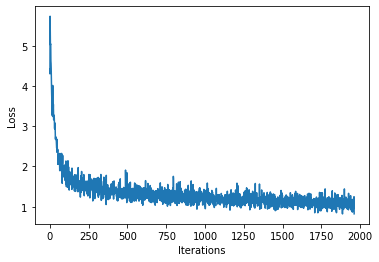

100%|██████████| 2000/2000 [00:52<00:00, 38.15it/s]


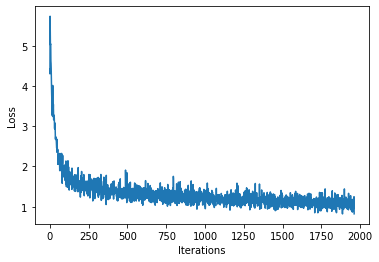

In [19]:
### Define optimizer and training operation ###


model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

optimizer = tf.keras.optimizers.Adam(learning_rate)

#Decorator
@tf.function                
def train_step(x, y): 
  with tf.GradientTape() as tape:
  
    y_hat = model(x) 
    loss = compute_loss(y, y_hat) 
  grads = tape.gradient(loss, model.trainable_variables) 
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss


# Begin training!#

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() 

for iter in tqdm(range(num_training_iterations)):

  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  history.append(loss.numpy().mean())
  plotter.plot(history)


  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)

model.save_weights(checkpoint_prefix)

## **Generating music using RNN**

In [20]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1) 
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_2 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_2 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [21]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  input_eval = [char2idx[s] for s in start_string] 
  input_eval = tf.expand_dims(input_eval, 0)
  text_generated = []

  
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      predictions = model(input_eval)
      predictions = tf.squeeze(predictions, 0)
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      input_eval = tf.expand_dims([predicted_id], 0)
      text_generated.append(idx2char[predicted_id])
    
  return (start_string + ''.join(text_generated))

In [22]:
generated_text = generate_text(model, start_string="X", generation_length=1000) 

100%|██████████| 1000/1000 [00:04<00:00, 221.08it/s]


 Playing Generated Music 

In [23]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  waveform = mdl.lab1.play_song(song)

  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 2 songs in text
Generated song 0


Generated song 1
